# Synchrony & Alignment
*Written by Luke Chang and based on a [tutorial on ISC](https://naturalistic-data.org/content/Intersubject_Correlation.html)*

Synchrony between individuals happens at several levels from behavior to brain activity ([Nummenmaa et al., 2018](https://www.sciencedirect.com/science/article/pii/S2352250X1830023X), [Nastase et al., 2019](https://academic.oup.com/scan/article/14/6/667/5489905)). To an observer, synchrony during interaction or joint motion ([Hale et al., 2020](https://link.springer.com/article/10.1007/s10919-019-00320-3)) can reflect prosocial qualities such rapport ([Miles et al., 2009](https://www.sciencedirect.com/science/article/pii/S0022103109000328)) or affiliation ([Hove and Risen, 2009](https://pdfs.semanticscholar.org/393f/e817c4e137335dc7b8c304be5037c15e716c.pdf)). During physically arousing ritualistic experiences, observers may selectively synchronize their heart rates while observing related, but not unrelated individuals participating in the ritual ([Konvalinka et al., 2011](https://www.pnas.org/content/pnas/108/20/8514.full.pdf)) and the degree of affective synchrony can predict the perceived social connection between two individuals ([Cheong et al., 2020](https://psyarxiv.com/bd9wn)). Synchrony of brain activity is associated with, among other things, shared psychological perspectives toward a stimulus ([Lahnakoski et al., 2014](https://www.sciencedirect.com/science/article/pii/S1053811914004996), [Yeshurun et al., 2017](https://psyarxiv.com/bd9wn), [Yeshurun et al., 2017](https://journals.sagepub.com/doi/full/10.1177/0956797616682029), [Kang & Wheatley, 2017](https://europepmc.org/article/med/28383993), [Cheong et al., 2020](https://psyarxiv.com/bd9wn)) and friendship ([Parkinson et al., 2018](https://www.nature.com/articles/s41467-017-02722-7)), and may also be disturbed in psychiatric conditions ranging from developmental conditions such as autism ([Hasson et al., 2009](https://onlinelibrary.wiley.com/doi/pdf/10.1002/aur.89); [Salmi et al., 2013](https://www.sciencedirect.com/science/article/pii/S2213158213001411), [Byrge et al., 2015](https://www.jneurosci.org/content/35/14/5837.short)) to more acute conditions such as first-episode psychosis ([Mäntylä et al., 2018](https://www.sciencedirect.com/science/article/pii/S0006322318314690)). Thus, measures of synchrony can offer a simple window to many psychological processes.

In brain imaging, synchrony of brain activity is most commonly measured using intersubject correlations (ISC; [Hasson et al., 2004](https://science.sciencemag.org/content/sci/303/5664/1634.full.pdf)). As the name implies, this method calculates linear correlations between participants and derives summary statistics from these correlations to measure the level of similarity of brain activity. Overall, the brain activity measured with fMRI during naturalistic stimulation conditions can be thought to consist of four main sources: (1) *stimulus-driven brain activity* between individuals shared by all or most of the participants, (2) individual or *idiosyncratic activity* elicited by the stimulus, (3) *intrinsic activity* that is not time-locked to the stimulus, and (4) *noise* from various sources. The idea behind ISC is to identify brain activity that is shared by a large proportion of the participants (category 1). Thus, this method evaluates how much of an individual’s brain activity is explained by this shared component. By contrast, if smaller groups of participants, e.g. pairs of friends within the study, share similar individual activity patterns (category 2), it may be better captured by the dyadic values in the pairwise matrices using techniques such as IS-RSA ([Parkinson et al., 2018](https://www.nature.com/articles/s41467-017-02722-7), [Chen et al., 2020](https://www.sciencedirect.com/science/article/pii/S1053811920303372), [Finn et al., 2020](https://www.sciencedirect.com/science/article/pii/S1053811920303153)). Generally, the third category of activity is not readily detected by ISC, but can be revealed using alternative techniques that don't necessarily assume time locking such as hidden markov models ([Chang et al., 2021](https://www.science.org/doi/10.1126/sciadv.abf7129)). Using inventive experimental designs, e.g. during verbal recall of previously experienced stimuli ([Chen et al., 2017](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5191958/)), it is still possible to extract shared brain activity patterns by temporally reorganizing the data, even when the original experiences of the participants were out of sync. The optimal choice of analysis will depend on the research question and the type of shared activity patterns that are of particular interest. Most commonly, ISCs are calculated locally within each voxel (or region), but this approach has also been extended to functional connectivity ([Simony et al., 2016](https://www.nature.com/articles/ncomms12141)). Intersubject correlations give a summary statistic of synchrony over long periods of time, usually over an entire imaging session. However, the level of synchrony may change considerably from one moment to the next with the experimental condition and can be investigated using time-varying measures of synchrony.

In this tutorial, we will cover:
- how to compute pairwise ISC
- how to perform hypothesis tests with ISC
data.org/features/notebooks/timecorr.html) tutorial)
- how to perform dynamic ISC
- how to apply isc to any feature space
- how to apply isc to a low dimensional feature space

## Computing Intersubject Correlation
### Pairwise vs Average Response
Generally, ISCs are calculated using one of two main approaches. First, one calculates **pairwise** correlations between all participant pairs to build a full intersubject correlation matrix. The second approach, uses the **average** activity timecourse of the other participants as a model for each individual left out participant. This procedure produces individual, rather than pairwise, spatial maps of similarity reflecting how similarly, or “typically”, each person’s brain activates. These maps lend themselves to similar analyses as one might perform with first level results of a traditional general linear model (GLM) analysis. However, some of the individual variability is lost with the latter approach, and thus the ISC values are typically of much higher magnitude compared to the pairwise matrices. 

### Summary Statistic
The next step after computing either the pairwise or average similarity across participants is to summarize the overall level of synchrony across participants. A straightforward approach is to compute the **mean** correlation. However, to make the correlation coefficients more normally distributed across the range of values, the Fisher’s Z transformation (inverse hyperbolic tangent) is typically applied before computing the mean correlation. The Fisher’s Z transformation mainly affects the higher end of absolute correlation values, eventually stretching the correlation coefficient 1 to infinity. However, with the typical range of values of pairwise ISCs, the effects of this transformation are relatively small reaching ~10% at the higher end of the scale of r=0.5. More recently, it has been suggested that computing the **median**, particularly when using the pairwise approach, provides a more accurate summary of the correlation values ([Chen et al., 2016](https://www.sciencedirect.com/science/article/pii/S1053811916301331)).

### Hypothesis tests
Performing hypothesis tests that appropriately account for the false positive rate can be tricky with ISC because of the dependence between the pairwise correlation values and the inflated number of variables in the pairwise correlation matrices. Though there have been proposals to use mixed-effects models for a parametric solution ([Chen et al., 2017](https://www.sciencedirect.com/science/article/pii/S1053811916304141)), we generally recommend using non-parametric statistics when evaluating the significance of these correlations. 

There are two general non-parametric approaches to performing hypothesis tests with ISC. The first method is a *permutation* or randomization method, achieved by creating surrogate data and repeating the same analysis many times to build an empirical null distribution (e.g. 5-10k iterations). However, to meet the exchangeability assumption, it is important to consider the temporal dependence structure. Surrogate data can be created by **circularly shifting** the timecourses of the participants, or **scrambling the phases** of the Fourier transform of the signals and transforming these scrambled signals back to the time domain ([Theiler et al., 1992](https://www.sciencedirect.com/science/article/pii/016727899290102S), [Lancaster et al., 2018](https://www.sciencedirect.com/science/article/pii/S0370157318301340)). Various blockwise scrambling techniques have also been applied and autoregressive models have been proposed to create artificial data for statistical inference . These approaches have the benefit that, when properly designed, they retain important characteristics of the original signal, such as the frequency content and autocorrelation, while removing temporal synchrony in the data. 

To illustrate these permutation based approaches, the animation below depicts the process of creating these null distributions and compares these to a similar distribution built based on real resting state data of the same duration in the same participants recorded just prior to the movie data in the same imaging study. Resting state is an ideal condition for demonstrating the true null distribution of no synchrony intersubject correlation as it involves no external synchronizing factors apart from the repeating noise of the scanner gradients, which are generally not of interest to us. Thus, any correlations in the resting state data arise by chance. As can be seen, the null distributions based on the surrogate data follow the distribution of resting state ISCs well as the number of iterations increases. However, the distributions are sometimes considered too liberal.

![null_distribution](../images/synchrony/NullMethodsVsMovieAndRest.gif)

The second approach employs a *subject-wise bootstrap* on the pairwise similarity matrices. Essentially, participants are randomly sampled with replacement and then a new similarity matrix is computed with these resampled participants. As a consequence of the resampling procedure, sometimes the same subjects are sampled multiple times, which introduces correlation values of 1 off the diagonal. Summarizing the ISC using the median can minimize the impact of these outliers. These values are then shifted by the real summary statistics to produce an approximately zero-centered distribution. Python implementations in Brainiak and nltools convert these values to NaNs by default so that they are not included in the overall ISC summary statistic. If you would like to learn more about resampling methods, we encourage you to read our [brief introduction](https://dartbrains.org/features/notebooks/15_Resampling_Statistics.html) available on the dartbrains course.

## Getting Started
Before getting started with this tutorial, we need to make sure you have the necessary software installed and data downloaded.

### Software
This tutorial requires the following Python packages to be installed. See the [Software Installation](http://naturalistic-data.org/features/notebooks/Software.html) tutorial for more information.

- seaborn
- matplotlib
- numpy
- scipy
- pandas
- nltools
- nilearn
- sklearn
- datalad

Let's now load the modules we will be using for this tutorial.

In [1]:
%matplotlib inline

import os
from tqdm.notebook import tqdm
import glob
import numpy as np
from numpy.fft import fft, ifft, fftfreq
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import gridspec
from matplotlib.animation import FuncAnimation
import seaborn as sns
from nltools.data import Brain_Data, Adjacency
from nltools.mask import expand_mask, roi_to_brain, create_sphere
from nltools.stats import (isc, isc_group, isfc, isps, fdr, threshold, phase_randomize, circle_shift, _butter_bandpass_filter, _phase_mean_angle, _phase_vector_length, zscore, align)
from nilearn.plotting import view_img_on_surf, view_img, plot_stat_map
from sklearn.metrics import pairwise_distances
from sklearn.utils import check_random_state
from scipy.stats import ttest_1samp, pearsonr
from scipy.signal import hilbert
from IPython.display import HTML
from fnl_tools.utils import rec_to_time
import datalad.api as dl
import warnings

warnings.simplefilter('ignore')


### Data
This tutorial will be using the **Friday Night Lights** dataset and will require downloading the Average ROI **csv** files.

We have already extracted the data for you to make this easier and have written out the average activity within each ROI into a separate csv file for each participant. If you would like to get practice doing this yourself, here is the code we used. Note that we are working with the hdf5 files as they load much faster than the nifti images, but either one will work for this example.

``` python
mask = Brain_Data('http://neurovault.org/media/images/2099/Neurosynth%20Parcellation_0.nii.gz')

file_list = glob.glob(os.path.join(download_path, 'ds003521', 'derivatives', 'denoised', 'smoothed', '*hdf5'))
for f in tqdm(file_list):
    sub_dat = Brain_Data(f)
    sub_roi = sub_dat.extract_roi(mask)
    sub_roi = pd.DataFrame(sub_roi).T
    output_name = f"{os.path.basename(f).split('_bold.hdf5')[0]}_average_roi.csv"
    sub_roi.to_csv(os.path.join(download_path, 'ds003521', 'derivatives', 'denoised', 'smoothed', output_name), index=False)
```

For now, we will be downloading the csv files directly from github, but you should also be able to do this using datalad, once some of the OpenNeuro syncing has completed. 

You will want to change `data_dir` to wherever you have installed the Friday Night Lights datalad repository. We will initialize a datalad dataset instance and get the files we need for this tutorial. If you've already downloaded everything, you can skip this cell. See the [Download Data Tutorial](http://naturalistic-data.org/features/notebooks/Download_Data.html) for more information about how to install and use datalad.

Here is example code:

``` python

data_dir = '/Users/lukechang/Downloads/FNL'

# If dataset hasn't been installed, clone from GIN repository
if not os.path.exists(data_dir):
    dl.clone(source='https://github.com/OpenNeuroDatasets/ds003521.git', path=data_dir)

# Initialize dataset
ds = dl.Dataset(data_dir)

# Get Cropped & Denoised CSV Files
result = ds.get(glob.glob(os.path.join(data_dir, 'derivatives', 'denoised', 'smoothed', f'*average_roi.csv')))
```

For this tutorial, you can also access the data directly from github.

``` python
sub_list = ['sub-sid000705',
 'sub-sid000708',
 'sub-sid000707',
 'sub-sid000678',
 'sub-sid000677',
 'sub-sid000475',
 'sub-sid000375',
 'sub-sid000681',
 'sub-sid000683',
 'sub-sid000498',
 'sub-sid000697',
 'sub-sid000698',
 'sub-sid000695',
 'sub-sid000692',
 'sub-sid000216',
 'sub-sid000570',
 'sub-sid000669',
 'sub-sid000688',
 'sub-sid000668',
 'sub-sid000573',
 'sub-sid000667',
 'sub-sid000671',
 'sub-sid000217',
 'sub-sid000529',
 'sub-sid000679',
 'sub-sid000476',
 'sub-sid000704',
 'sub-sid000706',
 'sub-sid000710',
 'sub-sid000680',
 'sub-sid000682',
 'sub-sid000494',
 'sub-sid000694',
 'sub-sid000699']

    
sub_timeseries = {}
for sub in tqdm(sub_list):
    sub_data = pd.read_csv(f'https://raw.githubusercontent.com/mind-tutorials/mind_book/master/data/fnl_average_roi/{sub}_task-movie_run-1_space-MNI152NLin2009cAsym_desc-preproc_trim_smooth6_denoised_average_roi.csv')
    sub_timeseries[sub] = sub_data
```

In [16]:
data_dir = '/Users/lukechang/Downloads/FNL'

# If dataset hasn't been installed, clone from GIN repository
if not os.path.exists(data_dir):
    dl.clone(source='https://github.com/OpenNeuroDatasets/ds003521.git', path=data_dir)

# Initialize dataset
ds = dl.Dataset(data_dir)

# Get Cropped & Denoised CSV Files
result = ds.get(glob.glob(os.path.join(data_dir, 'derivatives', 'denoised', 'smoothed', f'*average_roi.csv')))

# Load CSV files
file_list = glob.glob(os.path.join(data_dir, 'derivatives', 'denoised', 'smoothed', f'*average_roi.csv'))

sub_timeseries = {}
for f in tqdm(file_list):
    sub = os.path.basename(f).split('_')[0]
    sub_timeseries[sub] = pd.read_csv(f)


action summary:
  get (notneeded: 34)


  0%|          | 0/34 [00:00<?, ?it/s]

## Pairwise Synchrony
What if we were interested in examining if two subjects synchronized within their dmPFC while watching the movie?

There are many ways to test this, but a very straightforward approach is to simply correlate the timeseries of average activity within the dmPFC to the average activity from a different participant.

Ok, now let's download the k=50 whole brain meta-analytic parcellation of the neurosynth database ([de la Vega, 2016](https://www.jneurosci.org/content/36/24/6553?utm_source=TrendMD&utm_medium=cpc&utm_campaign=JNeurosci_TrendMD_0)) from [neurovault](https://neurovault.org/collections/2099/). Each ROI is indicated with a unique integer. We can expand this mask into 50 separate binary masks with the `expand_mask` function.  The dmPFC corresponds to an integer index of 2.

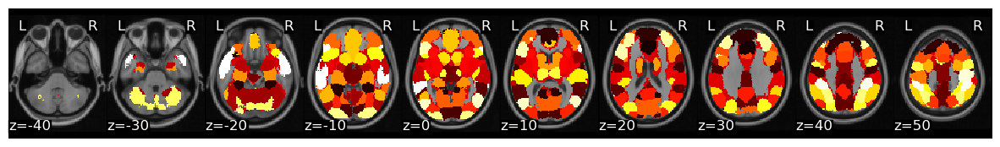

In [4]:
mask = Brain_Data('http://neurovault.org/media/images/2099/Neurosynth%20Parcellation_0.nii.gz')
mask_x = expand_mask(mask)

mask.plot()

Text(0.5, 1.0, 'Average time series within dmPFC - r=0.11')

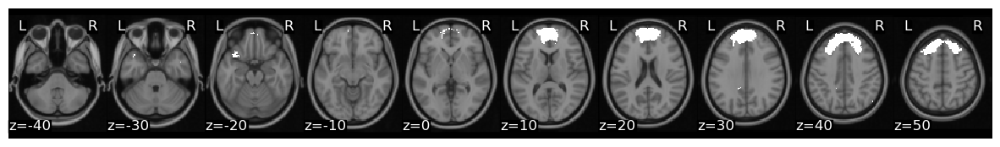

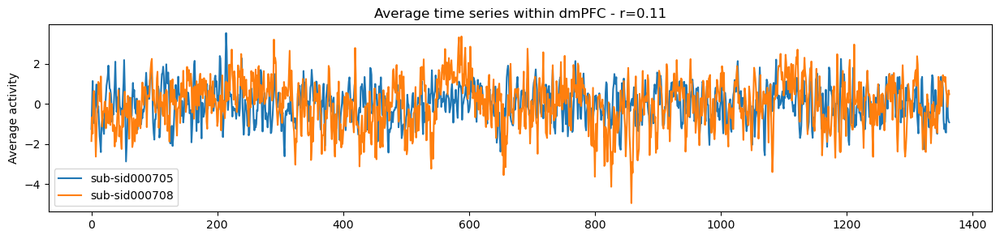

In [17]:
sub_1 = 'sub-sid000705'
sub_2 = 'sub-sid000708'

roi = 2

mask_x[roi].plot()

r, p = pearsonr(sub_timeseries[sub_1].iloc[:, roi], sub_timeseries[sub_2].iloc[:, roi])

f,a = plt.subplots(figsize=(15,3))
a.plot(sub_timeseries[sub_1].iloc[:, roi])
a.plot(sub_timeseries[sub_2].iloc[:, roi])
a.legend([sub_1, sub_2])
a.set_ylabel('Average activity')
a.set_title(f'Average time series within dmPFC - r={r:.02}')


As you can see this is very simple to assess overall synchrony. One thing that can be slightly more tricky is how to perform hypothesis tests to assess statistical significance. The p-values from the `pearsonr` scipy function assumes that each row of the data are independent, which is likely violated in this example as fMRI data tends to be autocorrelated. There are numerous ways to account for this using resampling statistics. We recommend using circle shifting or phase randomization, which are described in more detail below.


## Intersubject correlation (ISC) Analysis
Ok, now what if we were interested in assessing the overall level of synchrony across our entire sample? We can extend our pairwise synchrony concept to all participants and then summarizing the total pairwise synchrony using the mean or median.

let's see how ISC works with real data. In this tutorial, we will be computing ISC on average activity within 50 ROIs using data from the Friday Night Lights dataset using the nltools Python toolbox. We also recommend checking out the Brainiak [tutorial](https://brainiak.org/tutorials/10-isc/), and the Matlab [ISC-Toolbox](https://www.nitrc.org/projects/isc-toolbox/) ([Kauppi et al., 2014](http://www.frontiersin.org/neuroinformatics/10.3389/fninf.2014.00002/abstract)).



Now, let's pick a single ROI to demonstrate how to perform ISC analyses. We can pick any region, but let's continue with the dmPFC (roi=2), feel free to play with different regions as you work with the code.

We can plot the mask and create a new pandas DataFrame that has the average vmPFC activity for each participant.

,sub-sid000705,sub-sid000708,sub-sid000707,sub-sid000678,sub-sid000677,sub-sid000475,sub-sid000375,sub-sid000681,sub-sid000683,sub-sid000498,...,sub-sid000679,sub-sid000476,sub-sid000704,sub-sid000706,sub-sid000710,sub-sid000680,sub-sid000682,sub-sid000494,sub-sid000694,sub-sid000699
0,-1.257059,-1.858981,0.055510,-2.927054,0.001443,0.976214,-0.091158,1.122817,0.531115,-1.476508,...,-0.816042,-1.364593,0.133366,-2.057195,1.901717,-0.849037,-0.132114,-4.361229e+00,-0.863538,-1.691733
1,0.025426,-0.666974,-0.661008,-1.038320,-1.200573,0.360406,-0.165949,-0.136538,0.619254,-1.421292,...,-0.026740,-2.155036,0.347466,-2.337125,0.614552,-0.656935,-0.109674,-1.787996e-12,-0.656501,-1.883794
2,1.147395,-1.490594,-1.106923,-1.106748,-0.171776,0.517466,-0.011003,0.039086,-0.711524,-1.461454,...,1.600135,-2.700619,0.747714,-1.796568,1.175404,-0.381551,0.379087,-3.886152e-12,0.714567,-1.965230
3,-0.312306,0.235479,-0.832777,-2.265747,2.064173,1.440031,0.581691,1.074168,-0.916229,-0.676008,...,2.817513,-2.574495,1.161320,-1.159793,1.798948,-0.109981,0.521651,3.098448e-12,0.582420,-1.078426
4,-0.960072,0.649027,-0.094664,-2.235001,1.333921,1.734485,0.790967,0.677707,-0.524876,0.147219,...,2.265140,-0.002140,0.662223,-0.648039,1.305884,0.865690,-0.304318,-5.992719e-13,0.707843,-1.072950


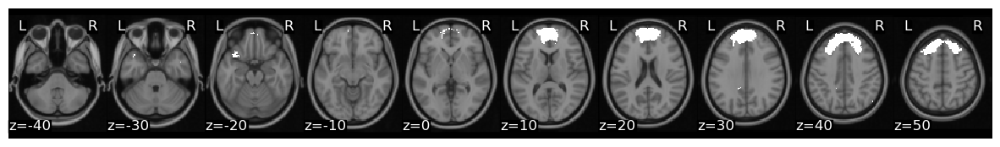

In [18]:
roi = 2

mask_x[roi].plot()

def get_subject_roi(data, roi):
    sub_rois = {}
    for sub in data:
        sub_rois[sub] = data[sub].iloc[:, roi]
    return pd.DataFrame(sub_rois)

sub_rois = get_subject_roi(sub_timeseries, roi)
sub_rois.head()

### Circle Shift Randomization
To perform ISC we will be using the `nltools.stats.isc` function. There are three different methods implemented to perform hypothesis tests (i.e., circular shifting data, phase randomization, and subject-wise bootstrap). We will walk through an example of how to run each one.

The idea behind circular shifting the data is to generate random surrogate data that has the same autoregressive and temporal properties of the original data ([Lancaster et al., 2018](https://www.sciencedirect.com/science/article/pii/S0370157318301340)). This is fairly straightforward and involves randomly selecting a time point to become the new beginning of the timeseries and then concatenating the rest of the data at the end so that it has the same length as the original data. Of course, there will potentially be a sudden change in the data where the two parts were merged.

To demonstrate how this works and that the circular shifted data has the same spectral properties of the original data, we will plot one subject's time series and shift it using the `nltools.stats.circle_shift` function. Next to both timeseries we plot the coefficients from a fast fourier transform.

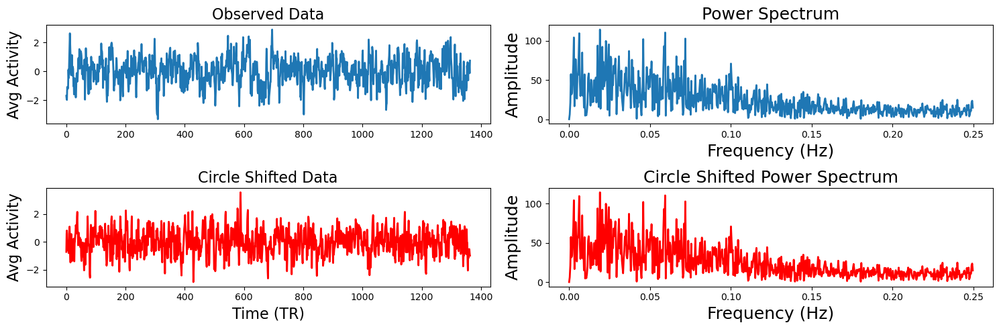

In [20]:
sub_1 = 'sub-sid000705'
sampling_freq = .5

f,a = plt.subplots(nrows=2, ncols=2, figsize=(15, 5))
a[0,0].plot(sub_rois[sub], linewidth=2)
a[0,0].set_ylabel('Avg Activity', fontsize=16)
a[0,1].set_xlabel('Time (TR)', fontsize=18)
a[0,0].set_title('Observed Data', fontsize=16)

fft_data = fft(sub_rois[sub_1])
freq = fftfreq(len(fft_data), 1/sampling_freq)
n_freq = int(np.floor(len(fft_data)/2))
a[0,1].plot(freq[:n_freq], np.abs(fft_data)[:n_freq], linewidth=2)
a[0,1].set_xlabel('Frequency (Hz)', fontsize=18)
a[0,1].set_ylabel('Amplitude', fontsize=18)
a[0,1].set_title('Power Spectrum', fontsize=18)

circle_shift_data = circle_shift(sub_rois[sub_1])
a[1,0].plot(circle_shift_data, linewidth=2, color='red')
a[1,0].set_ylabel('Avg Activity', fontsize=16)
a[1,0].set_xlabel('Time (TR)', fontsize=16)
a[1,0].set_title('Circle Shifted Data', fontsize=16)

fft_circle = fft(circle_shift_data)
a[1,1].plot(freq[:n_freq], np.abs(fft_circle)[:n_freq], linewidth=2, color='red')
a[1,1].set_xlabel('Frequency (Hz)', fontsize=18)
a[1,1].set_ylabel('Amplitude', fontsize=18)
a[1,1].set_title('Circle Shifted Power Spectrum', fontsize=18)

plt.tight_layout()

Now that you understand how the circular shifting method works with a single time series, let's compute the ISC of the Friday Night Lights viewing data within the dmPFC roi with 5000 permutations. The function outputs a dictionary that contains the ISC values, the p-value, the 95% confidence intervals, and optionally returns the 5000 samples. All of the permutation and bootstraps are parallelized and will use as many cores as your computer has available.

In [21]:
stats_circle = isc(sub_rois, method='circle_shift', n_samples=5000, return_null=True)

print(f"ISC: {stats_circle['isc']:.02}, p = {stats_circle['p']:.03}")

ISC: 0.085, p = 0.0002


### Phase Randomization
Next we will show how phase randomization works. This method projects the data into frequency space using a fast fourier transform and randomizes the phase and then projects the data back into the time domain ([Theiler et al., 1992](https://www.sciencedirect.com/science/article/pii/016727899290102S), [Lancaster et al., 2018](https://www.sciencedirect.com/science/article/pii/S0370157318301340)). If you would like to learn more about Fourier transforms, check out our tutorial on [Dartbrains](https://dartbrains.org/content/Signal_Processing.html). Similar to the circular shifting method, this generates a random surrogate of the data, while maintaining a similar temporal and autoregressive structure as the original data. We will generate the same plots from the example above to illustrate how this works using the `nltools.stats.phase_randomize` function.

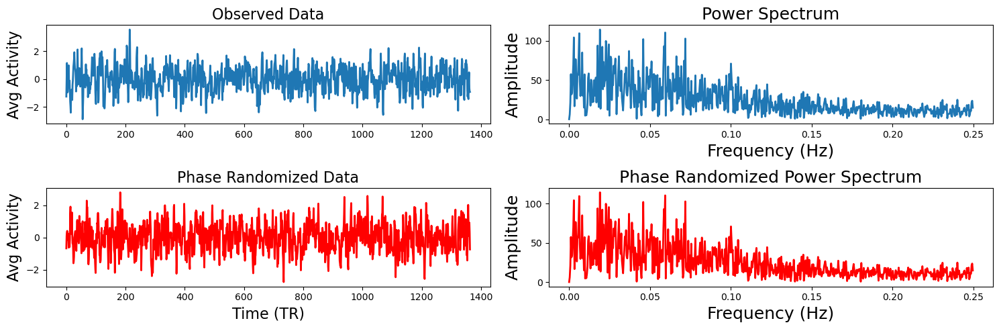

In [22]:
sub_1 = 'sub-sid000705'
sampling_freq = .5

f,a = plt.subplots(nrows=2, ncols=2, figsize=(15, 5))
a[0,0].plot(sub_rois[sub_1], linewidth=2)
a[0,0].set_ylabel('Avg Activity', fontsize=16)
a[0,1].set_xlabel('Time (TR)', fontsize=18)
a[0,0].set_title('Observed Data', fontsize=16)

fft_data = fft(sub_rois[sub_1])
freq = fftfreq(len(fft_data), 1/sampling_freq)
n_freq = int(np.floor(len(fft_data)/2))
a[0,1].plot(freq[:n_freq], np.abs(fft_data)[:n_freq], linewidth=2)
a[0,1].set_xlabel('Frequency (Hz)', fontsize=18)
a[0,1].set_ylabel('Amplitude', fontsize=18)
a[0,1].set_title('Power Spectrum', fontsize=18)

phase_random_data = phase_randomize(sub_rois[sub_1])
a[1,0].plot(phase_random_data, linewidth=2, color='red')
a[1,0].set_ylabel('Avg Activity', fontsize=16)
a[1,0].set_xlabel('Time (TR)', fontsize=16)
a[1,0].set_title('Phase Randomized Data', fontsize=16)

fft_phase = fft(phase_random_data)
a[1,1].plot(freq[:n_freq], np.abs(fft_phase)[:n_freq], linewidth=2, color='red')
a[1,1].set_xlabel('Frequency (Hz)', fontsize=18)
a[1,1].set_ylabel('Amplitude', fontsize=18)
a[1,1].set_title('Phase Randomized Power Spectrum', fontsize=18)

plt.tight_layout()

In [23]:
stats_phase = isc(sub_rois, method='phase_randomize', n_samples=5000, return_null=True)

print(f"ISC: {stats_phase['isc']:.02}, p = {stats_phase['p']:.03}")

ISC: 0.085, p = 0.0002


As you can see the ISC value is identical as the median of the pairwise correlations are identical. The p-values are also similar and likely reflect the limited precision of the possible p-values that can be computed using only 5,000 permutations. For greater precision, you will need to increase the number of permutations, but remember that this will also increase the computational time. 

### Subject-wise Bootstrapping
The final approach we will illustrate is subject-wise bootstrapping of the pairwise similarity matrix. This approach is more conservative than the previously described methods and is almost an order of magnitude faster shuffling the similarity matrix rather than recomputing the pairwise similarity for the null distribution ([Chen et al., 2016](https://www.sciencedirect.com/science/article/pii/S1053811916301331)). Bootstrapping and permutation tests are different types of resampling statistics (see our resampling [tutorial](https://dartbrains.org/features/notebooks/15_Resampling_Statistics.html) for a more in depth overview). Bootstrapping is typically used more for generating confidence intervals around an estimator, while permutation tests are used for performing hypothesis tests. However, p-values can also be computed using a bootstrap by subtracting the ISC from the null distribution and evaluating the percent of samples from the distribution that are smaller than the observed ISC ([Hall et al., 1991](https://www.jstor.org/stable/2532163#metadata_info_tab_contents)).

Just like the examples above, we will illustrate what an example bootstrapped similarity matrix looks like. Notice how some subjects are repeatedly resampled, which means that there are multiple values of perfect correlations found off the diagonal. This should be accounted for by using the **median** summary statistic of the lower triangle. However, both Brainiak and nltools toolboxes convert these values to NaNs to minimize the impact of these outliers on the summary statistic.

Text(0.5, 1.0, 'Bootstrapped Pairwise Similarity')

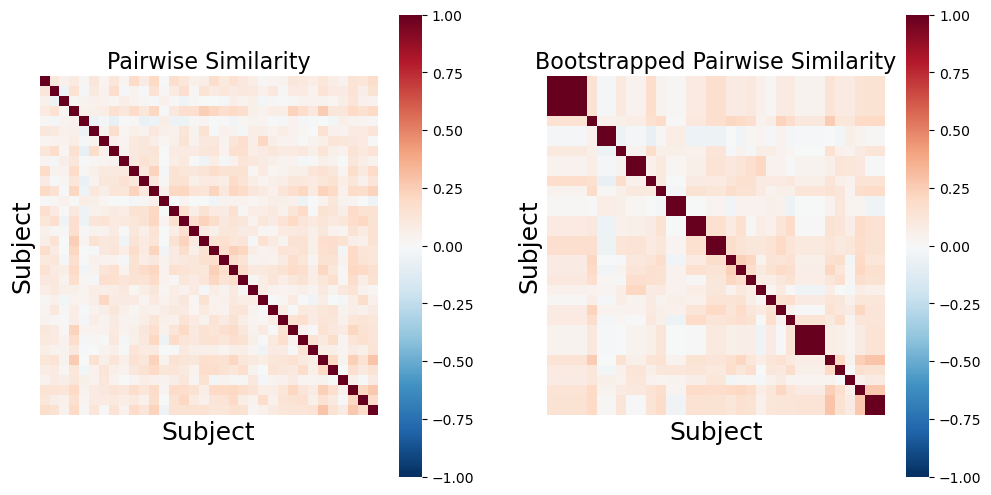

In [24]:
def bootstrap_subject_matrix(similarity_matrix, random_state=None):
    '''This function shuffles subjects within a similarity matrix based on recommendation by Chen et al., 2016'''
    
    random_state = check_random_state(random_state)
    n_sub = similarity_matrix.shape[0]
    bootstrap_subject = sorted(random_state.choice(np.arange(n_sub), size=n_sub, replace=True))
    return similarity_matrix[bootstrap_subject, :][:, bootstrap_subject]


similarity = 1 - pairwise_distances(pd.DataFrame(sub_rois).T, metric='correlation')

f,a = plt.subplots(ncols=2, figsize=(12, 6), sharey=True)
sns.heatmap(similarity, square=True, cmap='RdBu_r', vmin=-1, vmax=1, xticklabels=False, yticklabels=False, ax=a[0])
a[0].set_ylabel('Subject', fontsize=18)
a[0].set_xlabel('Subject', fontsize=18)
a[0].set_title('Pairwise Similarity', fontsize=16)

sns.heatmap(bootstrap_subject_matrix(similarity), square=True, cmap='RdBu_r', vmin=-1, vmax=1, xticklabels=False, yticklabels=False, ax=a[1])
a[1].set_ylabel('Subject', fontsize=18)
a[1].set_xlabel('Subject', fontsize=18)
a[1].set_title('Bootstrapped Pairwise Similarity', fontsize=16)

In [25]:
stats_boot = isc(sub_rois, method='bootstrap', n_samples=5000, return_null=True)

print(f"ISC: {stats_boot['isc']:.02}, p = {stats_boot['p']:.03}")

ISC: 0.085, p = 0.0002


The bootstrap procedure tends to run much faster than the permutation methods on our computer, which is one of the reasons that the authors of the toolbox recommend this approach, beyond it being more conservative ([Chen et al., 2016](https://www.sciencedirect.com/science/article/pii/S1053811916301331)).

### Null Distributions
Since each of our examples saved the null distribution, we can plot a histogram of the null distribution from each method including the confidence intervals. Notice that the circle shift and phase randomization methods produce highly similar null distributions and confidence intervals, while the bootstrap method has a wider and less symmetric distribution with the current number of iterations. However, the observed ISC of 0.085 (red line) exceeds all of the samples from the null distribution yielding a very small p-value. Notice that our observed null distributions using the surrogate data derived from the Sherlock data are very similar to the animation of null data presented above.


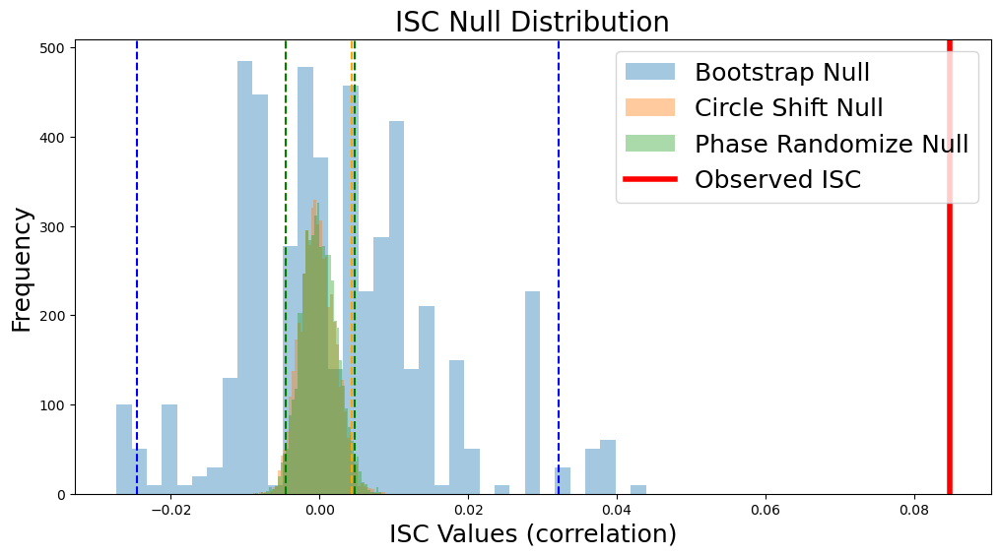

In [26]:
plt.figure(figsize=(12,6))
sns.distplot(stats_boot['null_distribution'] - stats_boot['isc'], kde=False, label='Bootstrap')
sns.distplot(stats_circle['null_distribution'], kde=False, label='Bootstrap')
sns.distplot(stats_phase['null_distribution'], kde=False, label='Bootstrap')
plt.ylabel('Frequency', fontsize=18)
plt.xlabel('ISC Values (correlation)', fontsize=18)
plt.title('ISC Null Distribution', fontsize=20)
plt.axvline(stats_boot['isc'], linestyle='-', color='red', linewidth=4)
plt.legend(['Bootstrap Null','Circle Shift Null', 'Phase Randomize Null','Observed ISC'], fontsize=18)

plt.axvline(stats_boot['ci'][0] - stats_boot['isc'], linestyle='--', color='blue')
plt.axvline(stats_boot['ci'][1] - stats_boot['isc'], linestyle='--', color='blue')

plt.axvline(stats_circle['ci'][0], linestyle='--', color='orange')
plt.axvline(stats_circle['ci'][1], linestyle='--', color='orange')

plt.axvline(stats_phase['ci'][0], linestyle='--', color='green')
plt.axvline(stats_phase['ci'][1], linestyle='--', color='green')

### Whole brain ISC
Now, let's calculate ISC looping over each of the 50 ROIs from the whole-brain meta-analytic parcellation ([de la Vega, 2016](https://www.jneurosci.org/content/36/24/6553?utm_source=TrendMD&utm_medium=cpc&utm_campaign=JNeurosci_TrendMD_0)). Here we loop over each ROI and grab the column from each subject's dataframe. We then run ISC on the combined subject's ROI timeseries using the median method and compute a hypothesis test using the subject-wise bootstrap method with 5000 samples ([Chen et al., 2016](https://www.sciencedirect.com/science/article/pii/S1053811916301331)). Finally, we convert each correlation and p-value from each region back into a Brain_Data instance.

In [29]:
isc_r, isc_p = {}, {}
for roi in tqdm(range(len(mask_x))):
    stats = isc(get_subject_roi(sub_timeseries, roi), n_samples=5000, metric='median', method='bootstrap')
    isc_r[roi], isc_p[roi] = stats['isc'], stats['p']
isc_r_brain, isc_p_brain = roi_to_brain(pd.Series(isc_r), mask_x), roi_to_brain(pd.Series(isc_p), mask_x)

  0%|          | 0/50 [00:00<?, ?it/s]

Now we can plot the ISC values to visualize which regions had a higher overall ISC.

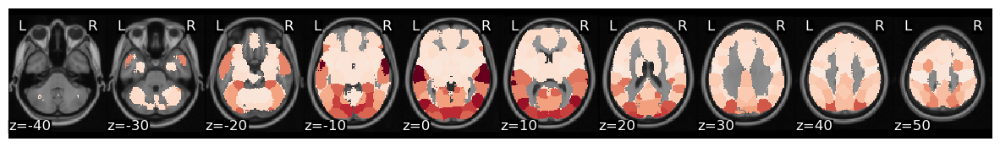

In [30]:
isc_r_brain.plot(cmap='RdBu_r')


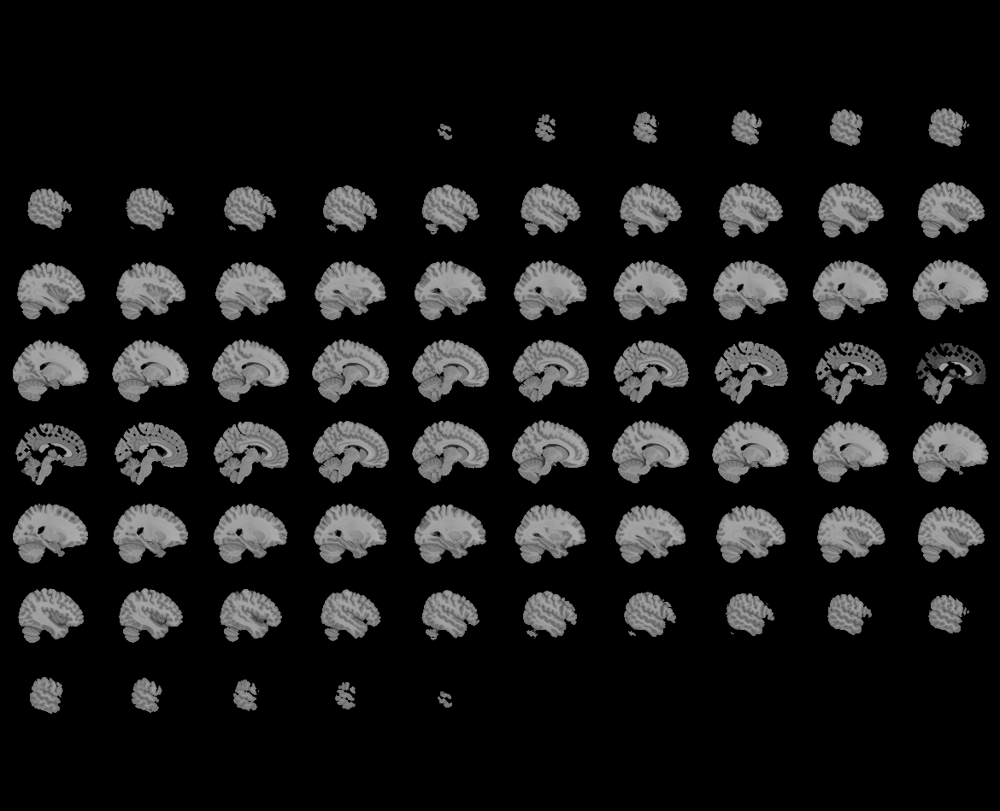
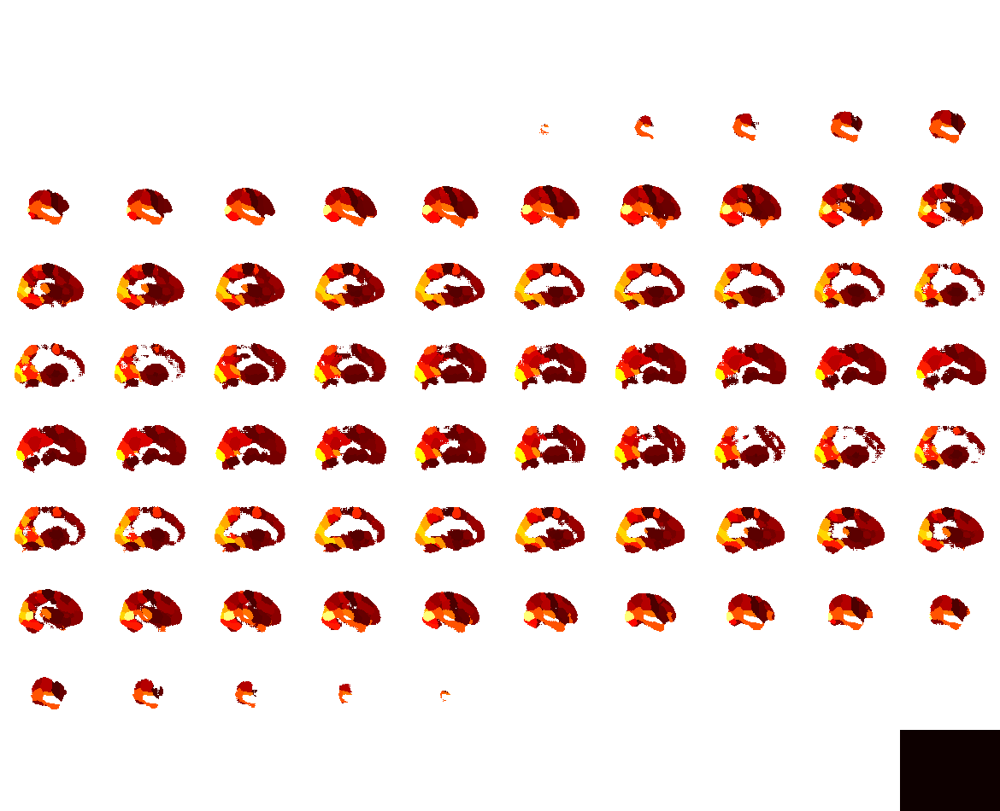

In [31]:
view_img(isc_r_brain.to_nifti())

We can threshold using bonferroni correction (p < 0.001 for k=50 parcellation). Alternatively, we can threshold using false discovery rate, by setting `thr=fdr(isc_p_brain.data)`. In this example, FDR is more conservative than bonferroni. 

In [32]:
view_img_on_surf(threshold(isc_r_brain, isc_p_brain, thr=.001).to_nifti())

## Temporal dynamics of intersubject synchrony
The majority of research using fMRI has focused on correlations calculated over entire datasets to reveal the average connectivity or intersubject similarity in a group of participants. However, functional brain networks are widely thought to be *dynamic*. Thus, it is not clear whether tools like correlation, which assumes a constant statistical dependence between the variables over the entire imaging session, are the most appropriate way to analyze data gathered during complex naturalistic stimulation.

A simple, and popular way of looking at temporal variability of synchrony while limiting the effects of signal amplitudes is to calculate correlations within sliding time windows. This allows the estimation of synchrony also during time windows when the signals are close to their mean values as the amplitude within each time window is standardized when the correlation is calculated. However, the length of the temporal window forces a trade-off between temporal accuracy and stability of the correlation coefficient calculated in that window. Very short time windows allow one to follow precisely when correlations occur, but short windows yield extremely unstable correlations, which can be dominated completely by e.g. single co-occurring spikes or slopes. Thus, sliding-window correlations in short time-windows are often characterized by extreme correlation values that change signs wildly.

Calculating the phase synchronization or phase locking of signals is one option to estimate time-varying synchronization of signals in a way that largely separates synchronization from signal amplitudes. It has been used widely for electrophysiological measures such as EEG and MEG, and more recently also for fMRI ([Glerean et al., 2012](https://www.liebertpub.com/doi/pdfplus/10.1089/brain.2011.0068)). Phase synchronization leverages the Hilbert transform to transform the real-valued signals into a complex valued, analytic signal, which is a generalization of the phasor notation of sinusoidal signals that are used widely in engineering applications. 

For illustration, two examples of analytic signals with constant frequency and amplitude are shown in the bottom panel of the animation, plotted in three dimensions (real, imaginary and time axes). We have used the cosine of the angular difference as a measure of pairwise synchrony. This produces time-averaged values that are consistent with the ISCs in the regions. In contrast to a time-invariant phasor, an analytic signal has a time-varying amplitude envelope and frequency and can thus be used to track changes in synchrony over time. However, for meaningful separation of the envelope and phase of the signal, the original signal has to be contained in a limited frequency band, which can be obtained through band-pass filtering. The smaller this frequency band is, the better the amplitude envelope is separated into a lower frequency than the phase of the signal in the pass-band ([Glerean et al., 2012](https://www.liebertpub.com/doi/pdfplus/10.1089/brain.2011.0068)). However, poorly designed filters may affect the shape of the signal considerably and in extreme cases even remove the signal of interest. For example, some filters can cause non-linear phase shifts across the frequency spectrum, or excessively tight pass-band may miss important frequencies completely.

![phase_synchrony](../images/isc/PhaseSynchronyAndCorrelation.gif)

Compared to sliding-window correlations, phase synchronization has the benefit that no explicit time windowing is required and synchronization is estimated at the original sampling frequency of the signals (though you still do need to choose a specific narrow frequency band). However, in a single pairwise comparison, phase synchrony can get extreme values by chance, much like a stopped clock that shows the right time twice a day. This is illustrated in the bottom panel of the animation. Despite the two signals being independent, the histogram on the left shows that many of the time points have extreme synchrony values. Accordingly, the estimate of mean synchrony oscillates with the phase of the signals, until eventually stabilizing around zero as expected for independent signals. Thus, phase synchrony of two signals has the potential of producing extreme synchrony values much like time windowed correlations. This can be mitigated by averaging. Averaging over the timepoints of a full session, intersubject phase synchronization (ISPS) of regional activity produces highly similar group-level results to ISC. However, this removes the benefit of the temporal accuracy of ISPS and is thus of limited use. By contrast, averaging over (pairs of) subjects improves the reliability of synchrony in a larger population while retaining the temporal accuracy.



### Intersubject Phase Synchrony 

Now, let's start working through some code to build an intuition for the core concepts behind intersubject phase synchrony (ISPS). We will begin by creating an animation of the phase angles.

First, we need to compute the instantaneous phase angle of our average ROI activity for each subject. We will use an infinite impulse response (IIR) bandpass butterworth filter. This requires specifying the **sampling_frequency** in cycles per second (i.e., Hz), which is $\frac{1}{tr}$, and lower and upper cutoff frequencies also in Hz. We will then apply a **hilbert** transform and extract the **phase angle** for each time point.

Let's extract signal from primary auditory cortex, which we can assume will synchronize strongly across participants (roi=35) and use a lower bound cutoff frequency of 0.04Hz and an upper bound of 0.07Hz as recommended by ([Glerean et al., 2012](https://www.liebertpub.com/doi/pdfplus/10.1089/brain.2011.0068)).

To visualize the data, we will plot 100 TRs of each participant's phase angles from the auditory cortex using a polar plot. Notice that for some time points all subjects have a different phase angle. These time points should have low synchrony values (i.e., resultant vector length close to zero). Other time points the phase angles will cluster together and all face the same direction. These time points will have high phase synchrony (i.e.,  resultant vector length close to one). We can also compute the mean phase angle for the group using circular statistics (red line). We don't actually care so much about the mean angle, but rather the **length of the resultant vector**. The resultant vector length is our metric of intersubject phase clustering, or the degree to which participants are in phase with each other at a given time point. Notice how the length gets shorter the more participants are out of phase and longer when they are all facing the same direction.


In [35]:
roi = 2
tr = 2
lowcut = .04
highcut = .07

phase_angles = np.angle(hilbert(_butter_bandpass_filter(get_subject_roi(sub_timeseries, roi), lowcut, highcut, 1/tr), axis=0))

xs, ys = [], []

fig = plt.figure(constrained_layout=False, figsize=(10,10))
spec = gridspec.GridSpec(ncols=4, nrows=4, figure=fig)

a0 = fig.add_subplot(spec[:2, :2], projection='polar')
plt.polar([0, _phase_mean_angle(phase_angles[0,:])], [0,1], color='red', linewidth=3)

a1 = fig.add_subplot(spec[:2, 2:4], projection='polar')
plt.polar([0, phase_angles[0,0]], [0,1], color='navy', linewidth=1, alpha=.2)

a2 = fig.add_subplot(spec[2:, :])
a2.plot(_phase_vector_length(phase_angles))
a2.set_ylabel('Phase Synchrony', fontsize=18)
a2.set_xlabel('Time (TRs)', fontsize=18)

def animate(i, xs, ys):
    xs = np.linspace(0, i, i+1, endpoint=True)
    ys = phase_angles[:i+1, :]
    
    a0.clear()
    a0.plot([0, _phase_mean_angle(phase_angles[i,:])], [0, _phase_vector_length(phase_angles[i,:])], color='red', linewidth=3)
    a0.set_title('Mean Phase Angle', fontsize=18)
    a0.set_ylim([0,1])
    
    a1.clear()
    for j in range(ys.shape[1]):
        a1.plot([0, phase_angles[i,j]], [0,1], color='navy', alpha=.5)  
    a1.set_title('Subject Phase Angles', fontsize=18)

    a2.clear()
    a2.plot(xs, _phase_vector_length(ys))
    a2.set_ylim([0,1])
    a2.set_ylabel('Resultant Vector Length', fontsize=18)
    a2.set_xlabel('Time (TRs)', fontsize=18)
    a2.set_title('Intersubject Phase Synchrony', fontsize=18)
    plt.tight_layout()
    
animation = FuncAnimation(fig, animate, fargs=(xs, ys), frames=range(150,200), interval=150, blit=False)
plt.close(animation._fig)
HTML(animation.to_jshtml())


<Figure size 640x480 with 0 Axes>

Ok, now that we have a better understanding of our measure of ISPS, let's pick a frequency band and plot the average phase synchrony over the entire 50min Sherlock viewing within each ROI from our parcellation. Let's continue using a lower bound cutoff frequency of 0.04Hz and an upper bound of 0.07Hz as recommended by ([Glerean et al., 2012](https://www.liebertpub.com/doi/pdfplus/10.1089/brain.2011.0068)).

In this example, we loop over each ROI and compute average ISPS over time and then project back into brain space.

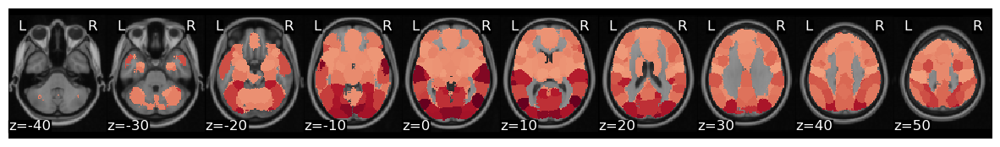

In [36]:
cutoff = (0.04, 0.07)
synchrony = {}
for roi in range(50):
    synchrony[roi] = isps(get_subject_roi(sub_timeseries, roi), low_cut=cutoff[0], high_cut=cutoff[1], sampling_freq=1/tr, order=5)['vector_length']
synchrony = pd.DataFrame(synchrony)

phase_synchrony_brain = roi_to_brain(pd.DataFrame(synchrony).mean(), mask_x)
phase_synchrony_brain.plot(cmap='RdBu_r')

Let's also create an interactive surface rendering. As you can see, these results look very similar to the whole timeseries ISC approach we used above. High overall synchrony across participants within primary auditory and visual cortices and lower overall synchrony in prefrontal and limbic regions.

In [37]:
view_img_on_surf(phase_synchrony_brain.to_nifti())

### Time - Frequency

In the previous example, we only looked at a specific frequency band (0.04-0.07Hz). It's possible that participants might differentially synchronize within different frequency bands ([Honey et al., 2012](https://www.sciencedirect.com/science/article/pii/S0896627312007179), [Kauppi et al., 2010](https://scholar.google.com/scholar?hl=en&as_sdt=0%2C30&q=kauppi+tohka&btnG=)). Let's create a *time-frequency* plot to see how ISPS changes over time within different frequency for a given ROI. Let's start by exploring the dorsomedial prefrontal cortex (dmPFC; roi=2), but feel free to explore different ROIs by changing the value of the variable.

We will loop over different cutoff bands. We will look at 25 linearly spaced frequency bins. Feel free to play around with the cutoffs if you're interested. Brighter colors indicate time points that have a higher level of ISPS within a specific TR. 

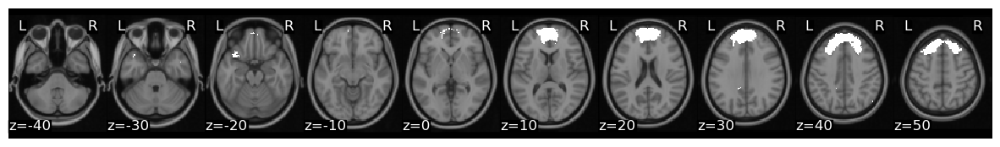

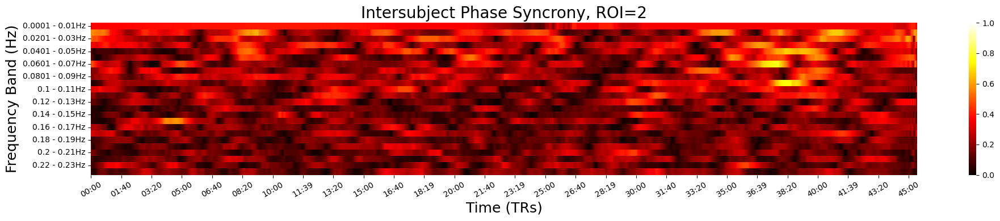

In [38]:
tr = 2
roi = 2

# Create 25 linearly spaced Frequency Bins
frequencies = [] 
for i,f in enumerate(np.linspace(.0001, .24, 25)):
    if i > 0:
        frequencies.append(tuple([prev_f, f]))
    prev_f = f

# Compute ISPS for each Frequency
time_freq = {}
for i,cutoff in enumerate(frequencies):
    time_freq[i] = isps(get_subject_roi(sub_timeseries, roi), low_cut=cutoff[0], high_cut=cutoff[1], sampling_freq=1/tr, order=5)['vector_length']

# Label Frequencies
time_freq = pd.DataFrame(time_freq).T
time_freq.index = [f'{f[0]:.03} - {f[1]:.02}Hz' for f in frequencies]

# Plot ROI
mask_x[roi].plot()
f,a = plt.subplots(nrows=1, figsize=(20, 4))

# Plot Heatmap
sns.heatmap(time_freq, cmap='hot', vmin=0, vmax=1, xticklabels=False, ax=a)
a.set_title(f'Intersubject Phase Syncrony, ROI={roi}', fontsize=20)
a.set_ylabel('Frequency Band (Hz)', fontsize=18)
a.set_xlabel('Time (TRs)', fontsize=18)
a.set_xticks(range(0, time_freq.shape[1],50))
a.set_xticklabels(rec_to_time(range(0,time_freq.shape[1],50), TR=tr), rotation=30)
plt.tight_layout()



### Hypothesis Tests


Statistics for time-varying measures of synchrony largely follow a similar non-parametric approach as discussed above. However, depending on the values that are used, statistics of phase synchrony differ slightly from linear measures of synchrony. In particular, [circular statistics](https://en.wikipedia.org/wiki/Directional_statistics) ([Fisher, 1995](https://books.google.com/books?hl=en&lr=&id=wGPj3EoFdJwC&oi=fnd&pg=PA1&dq=fisher+circular+statistics&ots=Pk3qBtzDPd&sig=nKKDV_lB6-DjqMipIm5EF2OzWeQ#v=onepage&q=fisher%20circular%20statistics&f=false)) can be used to estimate the parametric statistics of phase differences on the unit circle, as wrapping of the phase angle causes the angular difference to change signs as the signals rotate around the circle. 

For a parametric test, we can use the [Rayleigh test](https://en.wikipedia.org/wiki/Rayleigh_test) to determine if the intersubject phase angle synchrony is statistically significant, by testing the null hypothesis that the phase angles are uniformly distributed around a circle ([Fisher, 1995](https://books.google.com/books?hl=en&lr=&id=wGPj3EoFdJwC&oi=fnd&pg=PA1&dq=fisher+circular+statistics&ots=Pk3qBtzDPd&sig=nKKDV_lB6-DjqMipIm5EF2OzWeQ#v=onepage&q=fisher%20circular%20statistics&f=false)). If the phase angles cluster together in specific direction, they will have a large resultant vector and we can reject the null uniformity hypothesis.

Let's simulate what intersubject synchrony values would be significant at p < 0.05 given the sample size of N=16 in the Sherlock dataset. Here we plot the estimated p-values using the Rayleigh test across ISPS values ranging from $[0,1]$.

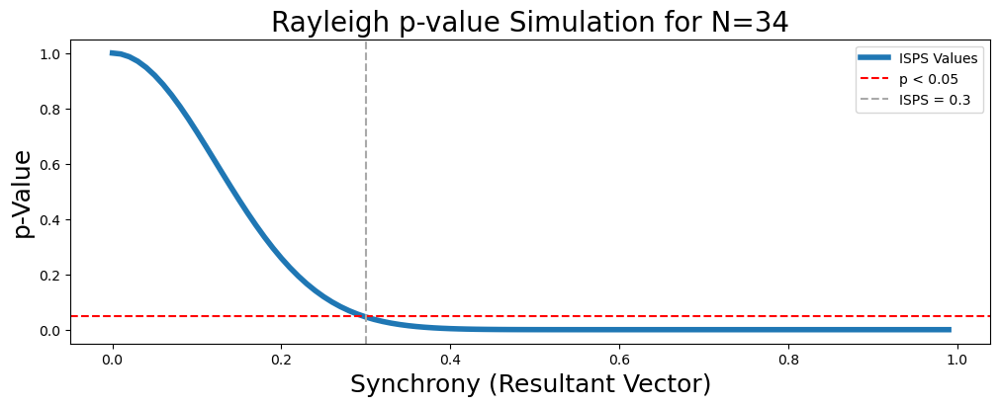

In [49]:
n = len(sub_timeseries)
R = np.arange(0,1, .01)
Z = n*(R**2)

p = np.exp(-1*Z)*(1 + (2*Z - Z**2)/(4*n) - (24*Z - 132*Z**2 +76*Z**3 - 9*Z**4)/(288*n**2))
r_threshold = R[np.min(np.where(p<0.05)[0])]

plt.figure(figsize=(12, 4))
plt.plot(R, p, linewidth=4)
plt.axhline(.05, linestyle='--', color='red')
plt.axvline(r_threshold, linestyle='--', color='darkgrey')
plt.ylabel('p-Value', fontsize=18)
plt.xlabel('Synchrony (Resultant Vector)', fontsize=18)
plt.title(f'Rayleigh p-value Simulation for N={len(sub_timeseries)}', fontsize=20)
plt.legend(['ISPS Values', 'p < 0.05', f'ISPS = {r_threshold}'])

As you can see, for an N of 34, an ISPS value of 0.3 corresponds to a significance value of approximately p < 0.05. This number will decrease as the number of participants increases and approaches the central limit theorem like any significance test. 

Note: just like all significance tests, you will need to consider controlling for multiple comparisons when repeated testing the same hypothesis across either space or time. 

Now, let's put this all together and compute ISPS at different frequency bands thresholding at a very liberal threshold of p < 0.05. We note that it is important to correct for multiple comparisons.

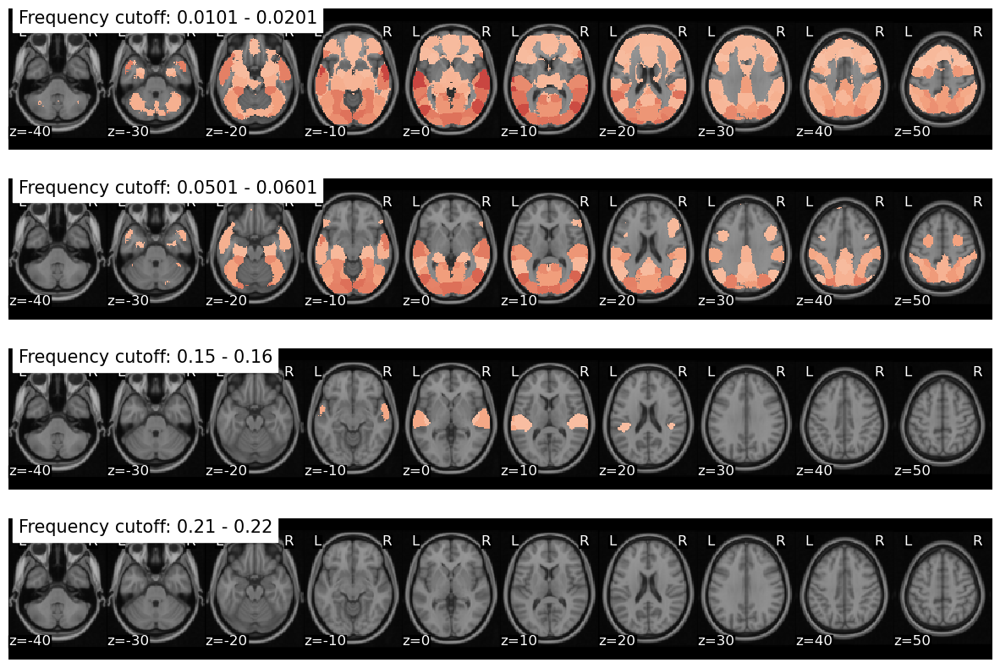

In [54]:
selected_frequencies = [frequencies[x] for x in [1, 5, 15, 21]]

f,a = plt.subplots(nrows = len(selected_frequencies), figsize=(15,10))
for i,cutoff in enumerate(selected_frequencies):
    synchrony = {}
    for roi in range(50):
        synchrony[roi] = isps(get_subject_roi(sub_timeseries, roi), low_cut=cutoff[0], high_cut=cutoff[1], sampling_freq=1/tr, order=5)['vector_length']
    phase_synchrony_brain = roi_to_brain(pd.DataFrame(synchrony).mean(), mask_x)
    phase_synchrony_brain.plot(cmap='RdBu_r', vmax=1, axes=a[i], threshold=r_threshold, title=f"Frequency cutoff: {cutoff[0]:.03} - {cutoff[1]:.03}")


Interestingly, similar to previous work ([Kauppi et al., 2010](https://scholar.google.com/scholar?hl=en&as_sdt=0%2C30&q=kauppi+tohka&btnG=)), we find not a lot of consistency at very fast frequencies (at least for fMRI), stronger ISPS in primary sensory regions including early visual and auditory, and a hint of higher ISPS spreading across more areas of cortex including lateral OFC and dmPFC at slower frequencies.


# Alignment 
Synchrony is often only considered in the context of temporal dynamics. However, we can also extend the concept of synchrony to alignment to any feature space. For example, with fMRI data, we could look at how much participants have a similar pattern of activity at particular moment in time to indicate spatial alignment. We could do this *within* an ROI, or also at the whole brain level *across* ROIs. 

For this example, we are going to compute the pairwise spatial alignment between two participants at each TR during the movie.

  0%|          | 0/1364 [00:00<?, ?it/s]

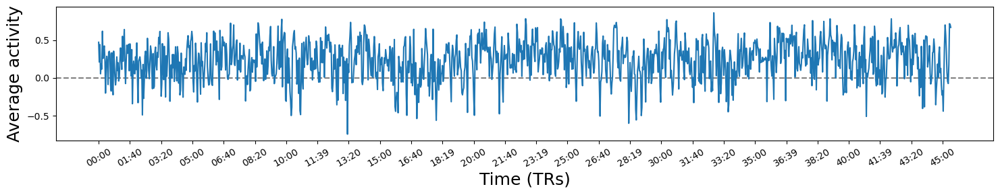

In [56]:
sub_1 = 'sub-sid000705'
sub_2 = 'sub-sid000708'

spatial_alignment = []
for timepoint in tqdm(range(1364)):
    r, p = pearsonr(sub_timeseries[sub_1].iloc[timepoint, :], sub_timeseries[sub_2].iloc[timepoint, :])
    spatial_alignment.append(r)

f,a = plt.subplots(figsize=(15,3))
a.axhline(0, linestyle='--', color='gray')
a.plot(spatial_alignment)
a.set_ylabel('Average activity', fontsize=18)
a.set_xlabel('Time (TRs)', fontsize=18)
a.set_xticks(range(0, time_freq.shape[1],50))
a.set_xticklabels(rec_to_time(range(0,time_freq.shape[1],50), TR=tr), rotation=30)
plt.tight_layout()


## Spatial Alignment
Just like temporal ISC, we can compute isc based on spatial information. This technique can allow us to assess a time-varying synchrony based on intersubject spatial alignment at every TR.

  0%|          | 0/1364 [00:00<?, ?it/s]

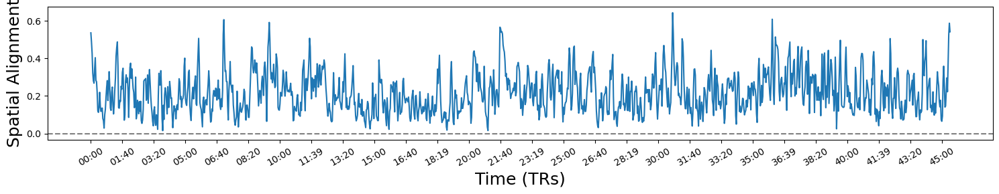

In [57]:
def get_subject_timepoint(data, timepoint):
    sub_timepoints = {}
    for sub in data:
        sub_timepoints[sub] = data[sub].iloc[timepoint, :]
    return pd.DataFrame(sub_timepoints)

spatial_alignment = []
for timepoint in tqdm(range(1364)):
    sub_timepoints = get_subject_timepoint(sub_timeseries, timepoint)
    spatial_alignment.append(isc(sub_timepoints, n_samples=1, return_null=True)['isc'])

f,a = plt.subplots(figsize=(15,3))
a.axhline(0, linestyle='--', color='gray')
a.plot(spatial_alignment)
a.set_ylabel('Spatial Alignment', fontsize=18)
a.set_xlabel('Time (TRs)', fontsize=18)
a.set_xticks(range(0, time_freq.shape[1],50))
a.set_xticklabels(rec_to_time(range(0,time_freq.shape[1],50), TR=tr), rotation=30)
plt.tight_layout()

# Alignment to latent states

Often we are interested in assessing how people might align in a latent feature space, or in a lower dimensional feature space. Here we will be showing how we can use tools developed initally for functionally aligning neuroimaging data. There has been growing interest in developing new algorithms to project subjects into a common space based on how a voxels respond to stimuli ([Haxby et al., 2011](https://www.sciencedirect.com/science/article/pii/S0896627311007811) ; [Guntupalli et al., 2016](https://academic.oup.com/cercor/article/26/6/2919/1754308)) or are connected to other voxels ([Guntupalli, et al., 2018](https://journals.plos.org/ploscompbiol/article?rev=1&id=10.1371/journal.pcbi.1006120)). These efforts have been largely lead by [Jim Haxby](http://haxbylab.dartmouth.edu/index.html) and [Peter Ramadge's](https://ee.princeton.edu/people/peter-j-ramadge) research groups over the past decade and are generally referred to as *hyperalignment*, or *functional alignment*. 

The basic idea behind hyperalignment is to treat cortical patterns as vectors corresponding to locations in a high dimensional space, where each axis reflects a measurement of that pattern (e.g., voxel activity) ([Haxby, 2014](https://www.annualreviews.org/doi/abs/10.1146/annurev-neuro-062012-170325)). Thus, rather than treating cortical functions in a 1D (average roi activity), 2D (cortical sheet), or 3D physical space, hyperalignment models information as being embedded in an n-dimensional space, where n reflects the number of measurements (e.g., voxels). Vector representations of cortical patterns can then be transformed into a common high dimensional space that is shared across participants. This idea of transforming individual cortical patterns into a common high dimensional model space can be seen in the following figure from ([Haxby et al., 2020](https://elifesciences.org/articles/56601)).

![hyperalignment](../images/hyperalignment/elife-56601-fig1-v1.jpg)

There are many different models of functional alignment. *Response-based hyperalignment* uses an iterative procrustes transform to scale, rotate, and reflect voxel time series so that they are in the same functional space across participants ([Haxby et al., 2011](https://www.sciencedirect.com/science/article/pii/S0896627311007811) ; [Guntupalli et al., 2016](https://academic.oup.com/cercor/article/26/6/2919/1754308)). *Connectivity-based hyperalignment* instead aligns voxels based on their embedding with other voxels using seed-based functional connectivity ([Guntupalli, et al., 2018](https://journals.plos.org/ploscompbiol/article?rev=1&id=10.1371/journal.pcbi.1006120)). There is also another approach called the *Shared Response Model*, which learns a joint-SVD and can project subjects into a lower dimensional common space ([Chen et al., 2014](https://ieeexplore.ieee.org/abstract/document/6958912), [Chen et al., 2015](http://papers.nips.cc/paper/5855-a-reduced-dimension-fmri-shared-response-model.pdf)). Overall, it has been shown that all of these different approaches can dramatically improve between subject classification accuracy particularly in [ventral temporal cortex](http://haxbylab.dartmouth.edu/publications/HGC+11.pdf). In addition, lower dimensional projections removes redundant axes in the high dimensional space and can effectively denoise the signal, which also improves classification accuracy. 

In this tutorial we will be using the Shared Response Model (SRM) to align participants to a lower dimensional spatial feature space.

## Shared Response Model (SRM)
The shared response model allows for the possibility of aligning in a lower dimensional functional space. Here we provide an example of aligning to a 5 dimensional features space. Previous work has found that this can potentially improve generalizability of multivariate models trained on an ROI compared to using as many features as voxels. We will zscore the data before training the model.

In [67]:
all_data_z = [zscore(sub_timeseries[x]).values for x in sub_timeseries]

srm = align(all_data_z, method='deterministic_srm', n_features=5)

the output of the align function is a dictionary that has all of the outputs of the model.

We can see the name of all of the output data using the `.keys()` method.

In [68]:
srm.keys()

dict_keys(['transformed', 'common_model', 'transformation_matrix', 'isc'])

### Plot ISC of each transformed Latent Component Time Course
We first might be interested in seeing the overall alignment to each latent component. However, unlike PCA, SRM does not order the latent compoennts in terms of variance explained. Let's plot the subject ISC for each transformed component.


Text(0.5, 0, 'Component')

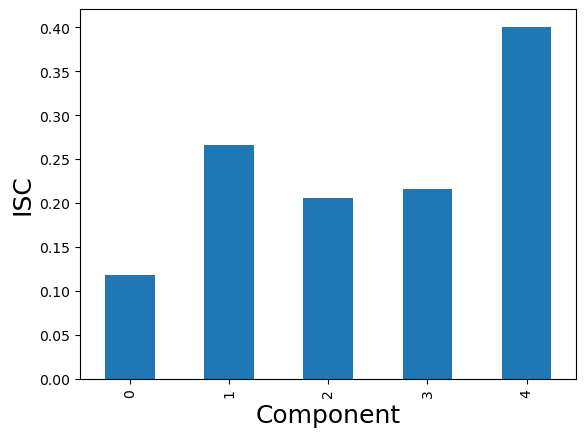

In [69]:
pd.Series(srm['isc']).plot(kind='bar')
plt.ylabel('ISC', fontsize=18)
plt.xlabel('Component', fontsize=18)

### Plot Aligned Latent Component Time Course
The shared response model is learning a common latent space within a lower dimensional subspace that is common to all participants. We can plot the average transformed time courses for each component. Here will arbitrarily select the component with the highest ISC.


Text(0.5, 1.0, 'Aligned Component ISC: r=0.4')

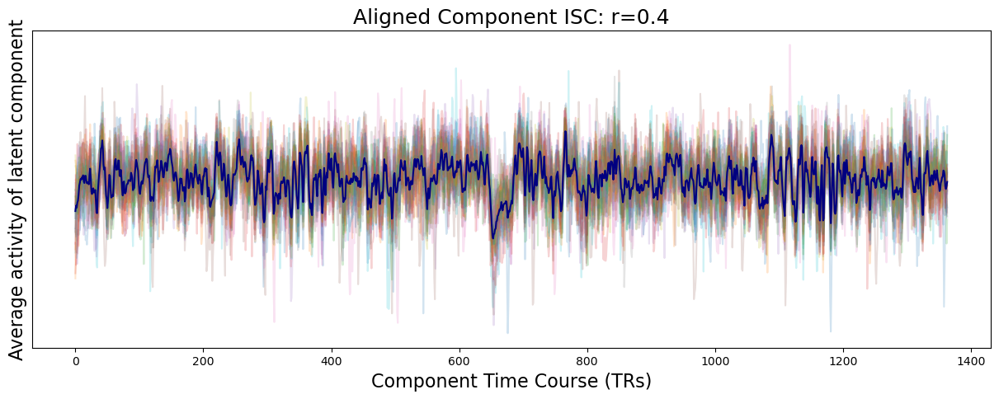

In [87]:
component_index = 4

component_aligned = pd.DataFrame([x[component_index, :] for x in srm['transformed']]).T

f, a = plt.subplots(nrows=1, figsize=(15, 5), sharex=True)
a.plot(component_aligned, linestyle='-', alpha=.2)
a.plot(np.mean(component_aligned, axis=1), linestyle='-', color='navy')
a.set_ylabel('Average activity of latent component', fontsize=16)
a.yaxis.set_ticks([])

plt.xlabel('Component Time Course (TRs)', fontsize=16)
a.set_title(f"Aligned Component ISC: r={Adjacency(component_aligned.corr(), matrix_type='similarity').mean():.02}", fontsize=18)


### Plot Subject Spatial Patterns associated with each latent component
Now let's look at how different regions contributed to this latent component for four example participants.


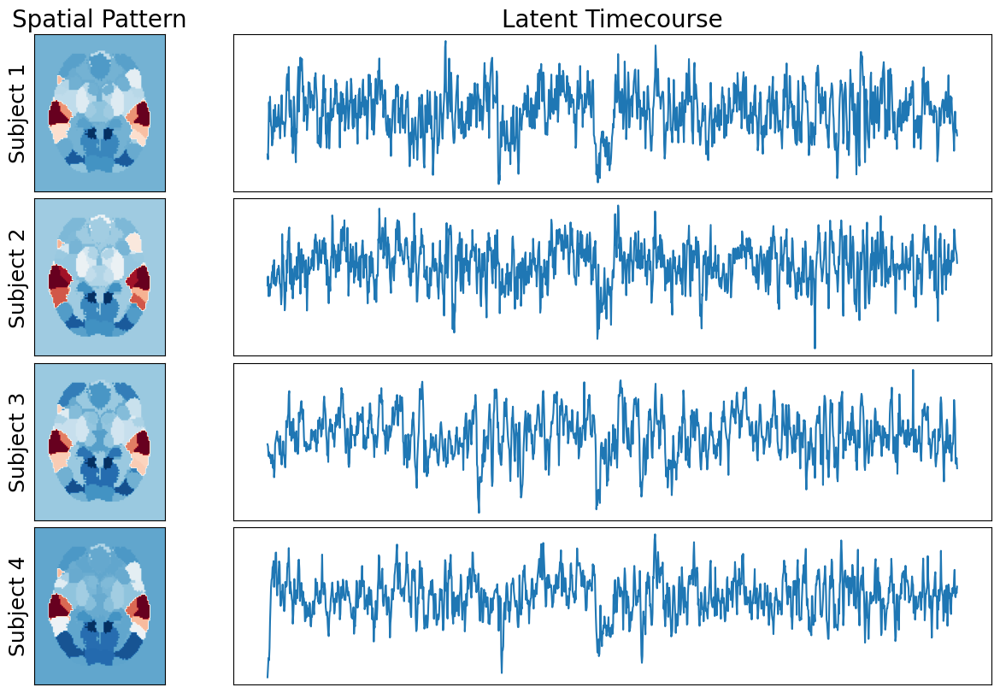

In [81]:
component = 4

f = plt.figure(constrained_layout=True, figsize=(12,8))
spec = gridspec.GridSpec(ncols=4, nrows=4, figure=f)
for i in range(4):
    a0 = f.add_subplot(spec[i, 0])
    a0.imshow(np.rot90(roi_to_brain(srm['transformation_matrix'][i][:,component], mask_x).to_nifti().dataobj[:, :, 37]),cmap='RdBu_r')
    a0.set_ylabel(f'Subject {i+1}', fontsize=18)
    a0.yaxis.set_ticks([])
    a0.xaxis.set_visible(False)    
    
    a1 = f.add_subplot(spec[i, 1:])
    a1.plot(srm['transformed'][i][component,:])
    a1.xaxis.set_visible(False)
    a1.yaxis.set_visible(False)

    if i < 1:
        a0.set_title('Spatial Pattern', fontsize=20)
        a1.set_title('Latent Timecourse', fontsize=20)


## Recommended reading
### Intersubject Synchrony

* Glerean, E., Salmi, J., Lahnakoski, J. M., Jääskeläinen, I. P., and Sams, M. (2012). Functional Magnetic Resonance Imaging Phase Synchronization as a Measure of Dynamic Functional Connectivity. Brain Connect. 2, 91–101. doi:10.1089/brain.2011.0068.

* Nastase, S. A., Gazzola, V., Hasson, U., & Keysers, C. (2019). Measuring shared responses across subjects using intersubject correlation. Social Cognitive and Affective Neuroscience, Volume 14, Issue 6, June 2019, Pages 667–685, https://doi.org/10.1093/scan/nsz037

* Nummenmaa, L., Lahnakoski, J. M., and Glerean, E. (2018). Sharing the social world via intersubject neural synchronisation. Curr. Opin. Psychol. 24. doi:10.1016/j.copsyc.2018.02.021.

* Simony, E., Honey, C. J., Chen, J., Lositsky, O., Yeshurun, Y., Wiesel, A., et al. (2016). Dynamic reconfiguration of the default mode network during narrative comprehension. Nat. Commun. 7. doi:10.1038/ncomms12141.

### Functional Alignment

* Haxby, J. V., Guntupalli, J. S., Nastase, S. A., & Feilong, M. (2020). Hyperalignment: Modeling shared information encoded in idiosyncratic cortical topographies. Elife, 9, e56601.


* Cohen, J. D., Daw, N., Engelhardt, B., Hasson, U., Li, K., Niv, Y., ... & Willke, T. L. (2017). Computational approaches to fMRI analysis. Nature neuroscience, 20(3), 304.


* Chen, P. H. C., Chen, J., Yeshurun, Y., Hasson, U., Haxby, J., & Ramadge, P. J. (2015). A reduced-dimension fMRI shared response model. In Advances in Neural Information Processing Systems (pp. 460-468).


* Guntupalli, J. S., Hanke, M., Halchenko, Y. O., Connolly, A. C., Ramadge, P. J., & Haxby, J. V. (2016). A model of representational spaces in human cortex. Cerebral cortex, 26(6), 2919-2934.
